In [1]:
from __future__ import print_function, division

from keras.datasets import mnist
from keras.layers import Input, Dense, Reshape, Flatten, Dropout, multiply, GaussianNoise
from keras.layers import BatchNormalization, Activation, Embedding, ZeroPadding2D
from keras.layers import LeakyReLU
from keras.layers.convolutional import UpSampling2D, Conv2D
from keras.models import Sequential, Model
from keras.optimizers import Adam
from keras import losses
from keras.utils import to_categorical
import keras.backend as K
from keras.layers import Lambda

import matplotlib.pyplot as plt
import numpy as np
import os
import matplotlib.animation as animation
import imageio








In [2]:
class AdversarialAutoencoder():
    def __init__(self):
        self.img_rows = 28
        self.img_cols = 28
        self.channels = 1
        self.img_shape = (self.img_rows, self.img_cols, self.channels)
        self.latent_dim = 10

        optimizer = Adam(0.0002, 0.5)

        # Build and compile the discriminator
        self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss='binary_crossentropy',
            optimizer=optimizer,
            metrics=['accuracy'])

        # Build the encoder / decoder
        self.encoder = self.build_encoder()
        self.decoder = self.build_decoder()

        img = Input(shape=self.img_shape)
        # The generator takes the image, encodes it and reconstructs it
        # from the encoding
        encoded_repr = self.encoder(img)
        reconstructed_img = self.decoder(encoded_repr)

        # For the adversarial_autoencoder model we will only train the generator
        self.discriminator.trainable = False

        # The discriminator determines validity of the encoding
        validity = self.discriminator(encoded_repr)

        # The adversarial_autoencoder model  (stacked generator and discriminator)
        self.adversarial_autoencoder = Model(img, [reconstructed_img, validity])
        self.adversarial_autoencoder.compile(loss=['mse', 'binary_crossentropy'],
            loss_weights=[0.999, 0.001],
            optimizer=optimizer)


    def build_encoder(self):
    # Encoder

      img = Input(shape=self.img_shape)

      h = Flatten()(img)
      h = Dense(512)(h)
      h = LeakyReLU(alpha=0.2)(h)
      h = Dense(512)(h)
      h = LeakyReLU(alpha=0.2)(h)
      mu = Dense(self.latent_dim)(h)
      log_var = Dense(self.latent_dim)(h)

      def sampling(args):
          mu, log_var = args
          epsilon = K.random_normal(shape=K.shape(mu), mean=0., stddev=1.)
          return mu + K.exp(log_var / 2) * epsilon

      latent_repr = Lambda(sampling, output_shape=(self.latent_dim,))([mu, log_var])

      return Model(img, latent_repr)


    def build_decoder(self):

        model = Sequential()

        model.add(Dense(512, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dense(512))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dense(np.prod(self.img_shape), activation='tanh'))
        model.add(Reshape(self.img_shape))

        model.summary()

        z = Input(shape=(self.latent_dim,))
        img = model(z)

        return Model(z, img)

    def build_discriminator(self):

        model = Sequential()

        model.add(Dense(512, input_dim=self.latent_dim))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dense(256))
        model.add(LeakyReLU(alpha=0.2))
        model.add(Dense(1, activation="sigmoid"))
        model.summary()

        encoded_repr = Input(shape=(self.latent_dim, ))
        validity = model(encoded_repr)

        return Model(encoded_repr, validity)

    def train(self, epochs, batch_size=128, sample_interval=50):
        # Load the dataset
        (X_train, _), (_, _) = mnist.load_data()

        # Rescale -1 to 1
        X_train = (X_train.astype(np.float32) - 127.5) / 127.5
        X_train = np.expand_dims(X_train, axis=3)

        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))

        for epoch in range(epochs):
            # Select a random batch of images
            idx = np.random.randint(0, X_train.shape[0], batch_size)
            imgs = X_train[idx]

            # Generate a batch of fake latent vectors
            latent_fake = self.encoder.predict(imgs)

            # Generate a batch of real latent vectors
            latent_real = np.random.normal(size=(batch_size, self.latent_dim))

            # ---------------------
            #  Train Discriminator
            # ---------------------

            # Train the discriminator on real and fake latent vectors
            d_loss_real = self.discriminator.train_on_batch(latent_real, valid)
            d_loss_fake = self.discriminator.train_on_batch(latent_fake, fake)
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)

            # ---------------------
            #  Train Generator
            # ---------------------

            # Train the generator on a batch of images
            g_loss = self.adversarial_autoencoder.train_on_batch(imgs, [imgs, valid])

            # Print the loss and accuracy for each epoch
            print(f"{epoch} [D loss: {d_loss[0]:.2f}, acc: {100 * d_loss[1]:.2f}%]"
                  f" [G loss: {g_loss[0]:.2f}, mse: {g_loss[1]:.2f}]")

            # If at save interval => save generated image samples
            if epoch % sample_interval == 0:
                self.sample_images(epoch)

    def sample_images(self, epoch):
        r, c = 5, 5
        noise = np.random.normal(0, 1, (r * c, self.latent_dim))
        gen_imgs = self.decoder.predict(noise)

        # Rescale images 0 - 1
        gen_imgs = 25 * gen_imgs + 0.5

        fig, axs = plt.subplots(r, c, figsize=(10, 10))
        cnt = 0
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow(gen_imgs[cnt, :,:,0], cmap='gray')
                axs[i,j].axis('off')
                cnt += 1

        plt.suptitle(f"MNIST dataset Generated Images (Epoch {epoch})", fontsize=24)

        # Save the generated image samples to a file
        sample_dir = r"E:\Tensorflow\All_Projects\Autoencoder\MNIST_images_generated"
        if not os.path.exists(sample_dir):
            os.makedirs(sample_dir)
        filename = f"{sample_dir}/mnist_{epoch}.png"
        plt.savefig(filename)
        # plt.show()

        # Create a GIF of the generated image samples
        with imageio.get_writer(f"{sample_dir}/mnist.gif", mode='I') as writer:
            for i in range(epoch):
                filename = f"{sample_dir}/mnist_{i}.png"
                writer.append_data(imageio.imread(filename))
        writer.close()








Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_10 (Dense)            (None, 512)               5632      
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 512)               0         
                                                                 
 dense_11 (Dense)            (None, 256)               131328    
                                                                 
 leaky_re_lu_7 (LeakyReLU)   (None, 256)               0         
                                                                 
 dense_12 (Dense)            (None, 1)                 257       
                                                                 
Total params: 137,217
Trainable params: 137,217
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_3"
__________________________

C:\Users\ZUBAIR\AppData\Local\Temp\ipykernel_13896\750853383.py:152: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(r, c, figsize=(10, 10))


4/4 [==============================] - 0s 2ms/step
21 [D loss: 0.13, acc: 99.61%] [G loss: 0.25, mse: 0.25]
4/4 [==============================] - 0s 1ms/step
22 [D loss: 0.13, acc: 100.00%] [G loss: 0.26, mse: 0.25]
4/4 [==============================] - 0s 1ms/step
23 [D loss: 0.13, acc: 100.00%] [G loss: 0.26, mse: 0.25]
4/4 [==============================] - 0s 1ms/step
24 [D loss: 0.13, acc: 99.61%] [G loss: 0.25, mse: 0.25]
4/4 [==============================] - 0s 996us/step
25 [D loss: 0.12, acc: 99.61%] [G loss: 0.26, mse: 0.25]
4/4 [==============================] - 0s 1ms/step
26 [D loss: 0.10, acc: 100.00%] [G loss: 0.26, mse: 0.25]
4/4 [==============================] - 0s 996us/step
27 [D loss: 0.10, acc: 99.61%] [G loss: 0.24, mse: 0.24]
4/4 [==============================] - 0s 999us/step
28 [D loss: 0.09, acc: 99.22%] [G loss: 0.24, mse: 0.23]
4/4 [==============================] - 0s 2ms/step
29 [D loss: 0.09, acc: 100.00%] [G loss: 0.25, mse: 0.24]
4/4 [=============

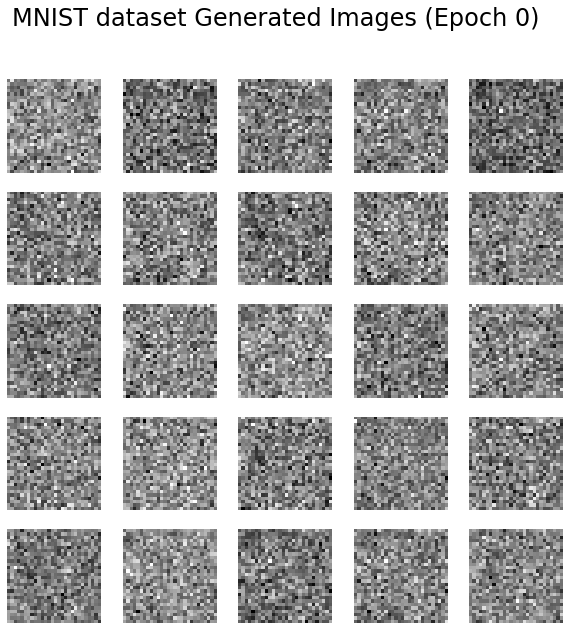

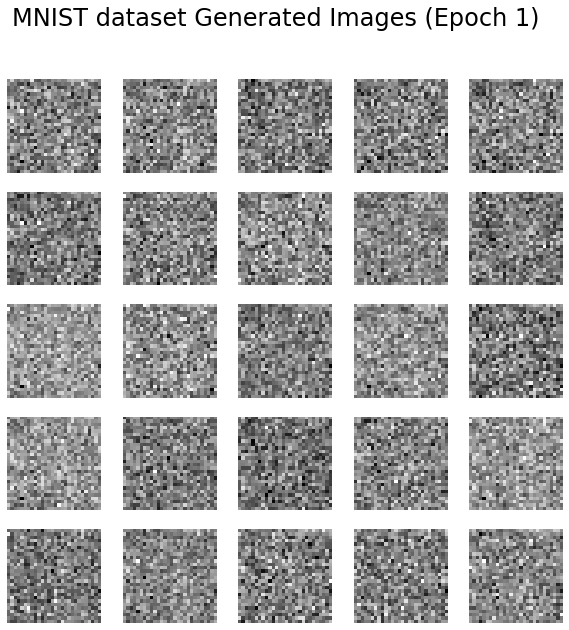

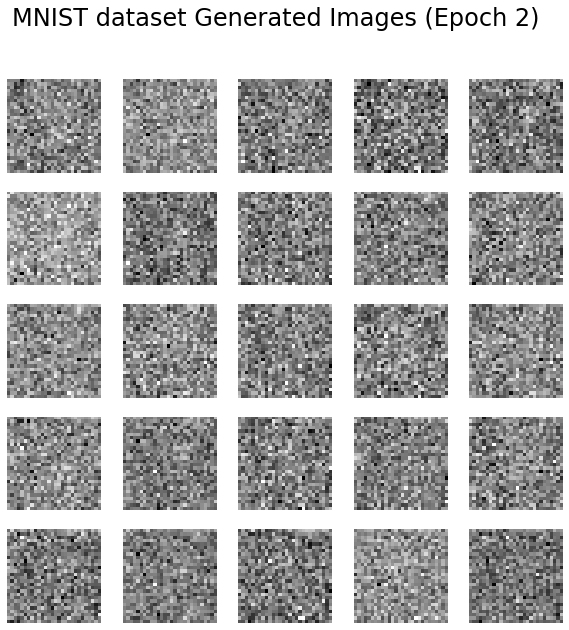

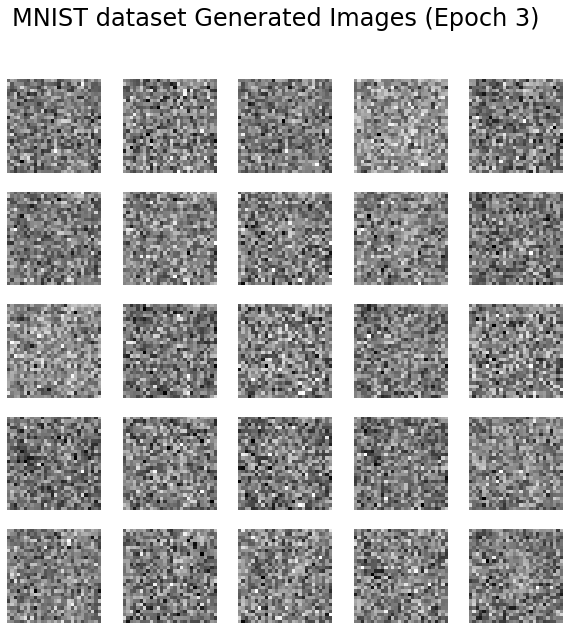

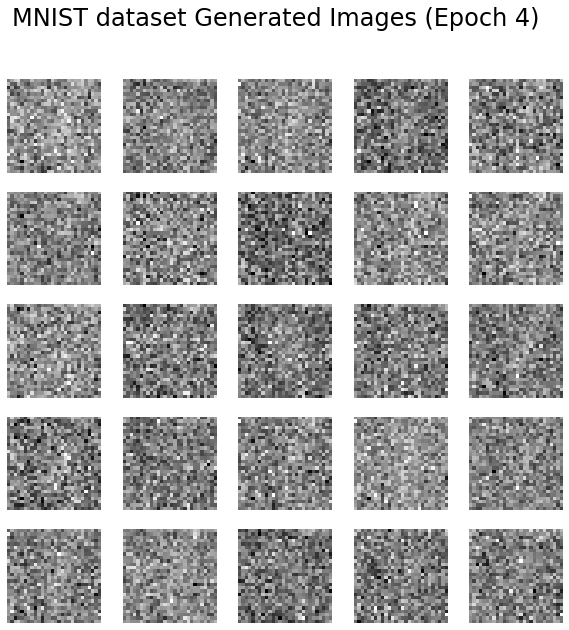

...

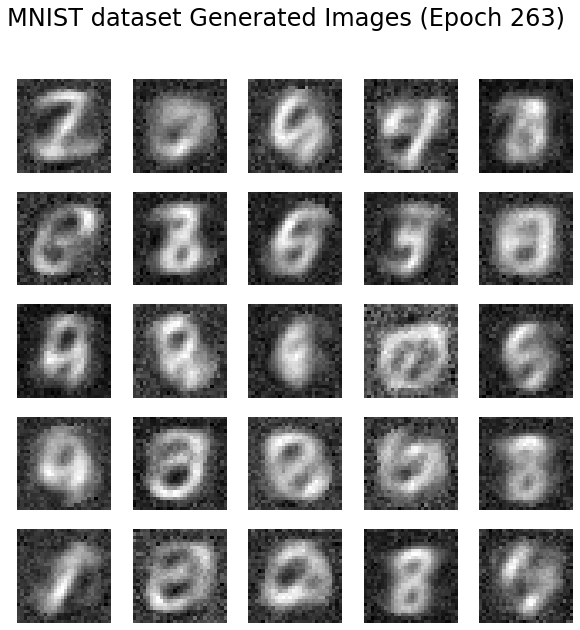

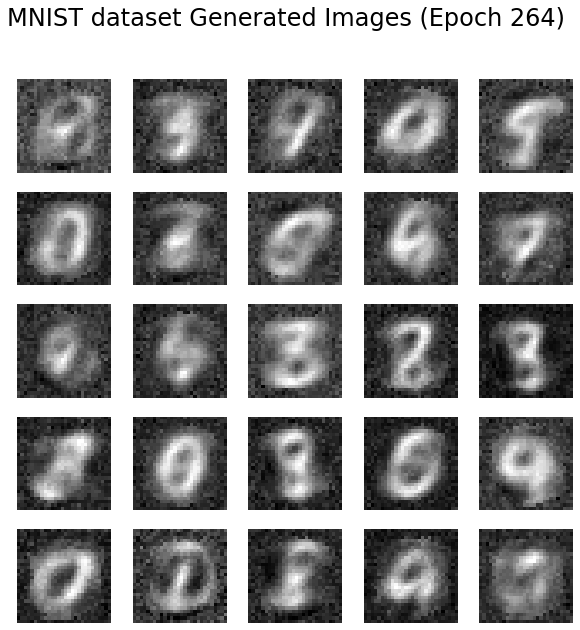

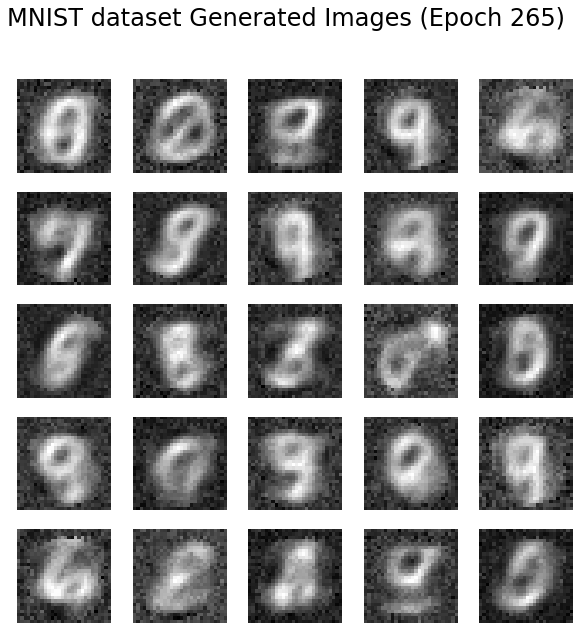

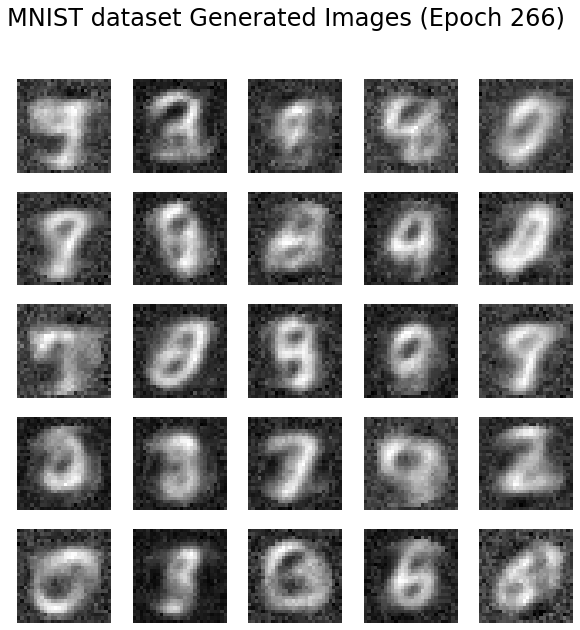

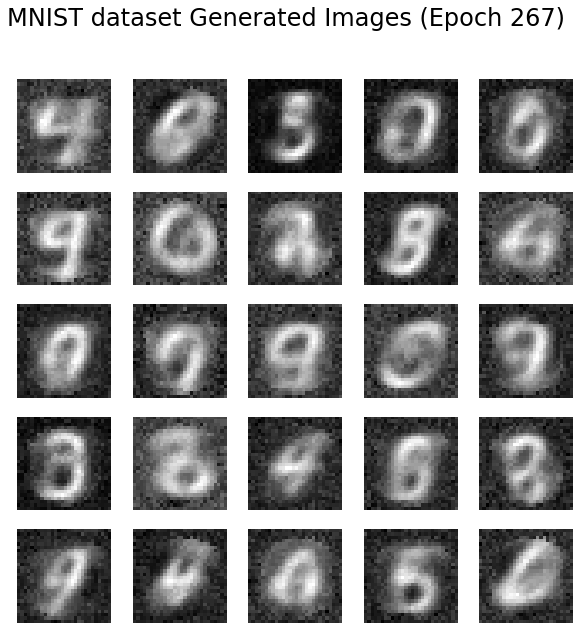

In [ ]:
if __name__ == '__main__':
    autoencoder = AdversarialAutoencoder()
    autoencoder.train(epochs=600, batch_size=128, sample_interval=1)

In [ ]:
-- Training is done till 600 epochs however GANs itself are compuational intensive so training
it for longer will improve the results probably 5000 epochs helps to improve the model

In [ ]:
### Completed - Thanks